# PART 1: Data Exploration and Data Cleaning

In [1]:
#pip install html5lib

     |████████████████████████████████| 112 kB 1.3 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [2]:
# Import necessary libraries

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import plotly.express as px

from datetime import datetime
import re

from unidecode import unidecode
from bs4 import BeautifulSoup
import requests
import html5lib

pd.set_option('display.max_rows', None)

import warnings
warnings.filterwarnings(action='ignore')

## 1. Loading and general exploration of the data

In [3]:
# Load the dataset

data = pd.read_excel("/Users/giulianooscarstefanelli/Downloads/projects.xlsx")
data.head()

,Tipo de Entidad,Agrupación IT Demanda,Plan,Dominio,Programa,Clave,Resumen,Gestor Demanda,Unidad IT,Categoría,...,Costes recurrentes solicitado,Informacional,Área Peticionaria,Áreas involucradas,Agrupado PEP,Preselección para TCA,Otros costes,Mejoras Beneficios,Justificación Scoring y Unidades Colaboradoras,Unidades Colaboradoras
0,Business Case,SISTEMAS CORPORATIVOS,Financiera,Financial Reporting & Control,"PG-592, Capital Regulatorio y Control",PPR-41206,Capital Regulatorio Q1/Q2,JOSE ISAAC OSORIO TORRON,7614 - Finanzas,Mejoras aplicativas,...,NaN,No,7994 - Financiera y Finanzas Sostenibles,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,Scoring no realizado. No considero necesaria l...
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Business Case,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-593, Venta de carteras",PPR-41175,Depuración BDD Venta Carteras,BERNAT PRADES ALGUERO,5881 - C&R y Gestión de Activos Irregulares,Mejoras aplicativas,...,NaN,Si,7932 - Riesgos,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,Scoring no realizado. No considero necesaria l...
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [54]:
data[['Agrupación IT Demanda', 'Plan','Dominio', 'Programa']]

,Agrupación IT Demanda,Plan,Dominio,Programa
0,SISTEMAS CORPORATIVOS,Financiera,Financial Reporting & Control,"PG-592, Capital Regulatorio y Control"
3,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-593, Venta de carteras"
6,OPERACIONES Y TECNOLOGÍA EMPRESAS Y RED,Financiaciones,Producto,"PG-772, Financiaciones"
9,OPERACIONES Y TECNOLOGÍA PARTICULARES,"Prestamos, Tarjetas y Pagos",Préstamos,"PG-560, Financiación Préstamos"
12,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-594, Recuperaciones - Resolución findings O..."
15,SABIS - SERVICIOS TECNOLÓGICOS,Servicios Tecnológicos,Production,"PG-390, Resiliencia"
18,OPERACIONES Y TECNOLOGÍA PARTICULARES,Hipotecas & Consumer Finance,Hipotecas,"PG-525, Proceso hipotecario"
21,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-306, Oficina de garantías"
24,OPERACIONES Y TECNOLOGÍA PARTICULARES,"Prestamos, Tarjetas y Pagos",Préstamos,"PG-560, Financiación Préstamos"
27,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-593, Venta de carteras"


In [4]:
# Removing empty rows

data = data[data['Tipo de Entidad'].notnull()]

In [5]:
#data.to_excel('data_no_empty_rows.xlsx')

In [6]:
# Check data types
data.dtypes

Tipo de Entidad                                           object
Agrupación IT Demanda                                     object
Plan                                                      object
Dominio                                                   object
Programa                                                  object
Clave                                                     object
Resumen                                                   object
Gestor Demanda                                            object
Unidad IT                                                 object
Categoría                                                 object
IT Manager                                                object
Fast Track                                                object
Prioridad                                                 object
Total Solicitado €                                       float64
Fecha inicio                                      datetime64[ns]
Fecha fin                

In [6]:
# Check Number of rows
len(data)

3010

## 2. Department / people exploration
### 2.1 Agrupación IT Demanda

In [8]:
# Unique values
tabla_aid = data["Agrupación IT Demanda"].value_counts()
print(tabla_aid)

SISTEMAS CORPORATIVOS                         1123
OPERACIONES Y TECNOLOGÍA PARTICULARES          383
OPERACIONES Y TECNOLOGÍA EMPRESAS Y RED        355
OPERACIONES Y TECNOLOGÍA BANCA CORPORATIVA     337
SABIS - SERVICIOS TECNOLÓGICOS                 202
5599                                           202
TECNOLOGÍA                                     150
SABIS - SERVICIOS DE DESARROLLO                 78
GESTIÓN DE COSTES                               67
9031                                            36
INNOCELLS                                       29
DIGITAL, SERVICING Y VENTAS REMOTAS             16
9608                                            16
SERVICIOS TECNOLÓGICOS                          10
PLANIFICACIÓN IT&OPS                             6
Name: Agrupación IT Demanda, dtype: int64


In [8]:
len(tabla_aid)

SISTEMAS CORPORATIVOS                         1123
OPERACIONES Y TECNOLOGÍA PARTICULARES          383
OPERACIONES Y TECNOLOGÍA EMPRESAS Y RED        355
OPERACIONES Y TECNOLOGÍA BANCA CORPORATIVA     337
SABIS - SERVICIOS TECNOLÓGICOS                 202
5599                                           202
TECNOLOGÍA                                     150
SABIS - SERVICIOS DE DESARROLLO                 78
GESTIÓN DE COSTES                               67
9031                                            36
INNOCELLS                                       29
DIGITAL, SERVICING Y VENTAS REMOTAS             16
9608                                            16
SERVICIOS TECNOLÓGICOS                          10
PLANIFICACIÓN IT&OPS                             6

15

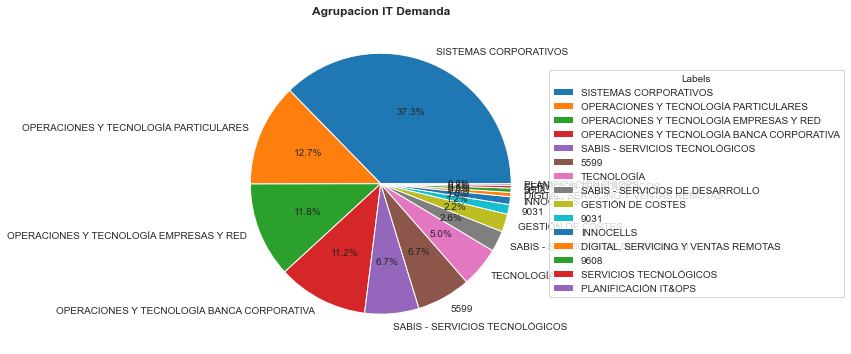

In [13]:
sns.set_style("whitegrid")
plt.figure(figsize=(8,6))
plt.pie(tabla_aid.values, labels=tabla_aid.index, autopct='%1.1f%%')
plt.title("Agrupacion IT Demanda", fontweight='bold')
plt.legend(title="Labels", labels=tabla_aid.index, loc="center left", bbox_to_anchor=(1, 0.5))
plt.show()

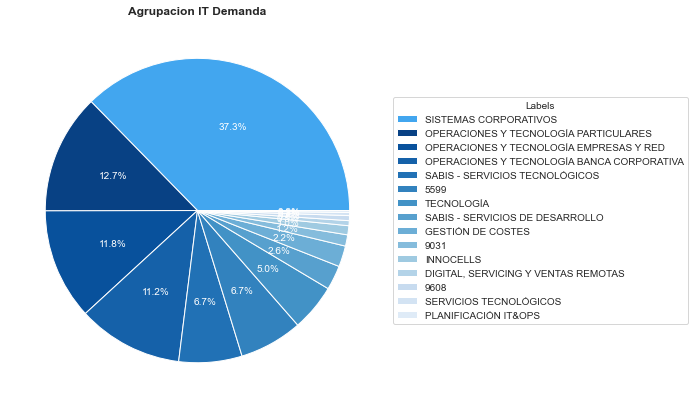

In [25]:
# new graph

colors = sns.color_palette("Blues_r", len(tabla_aid.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(tabla_aid.values, autopct='%1.1f%%', colors=color_map, textprops={'color':"white"})
plt.legend(title="Labels", labels=tabla_aid.index, loc="center left", bbox_to_anchor=(1, 0.5))
plt.title("Agrupacion IT Demanda", fontweight='bold')
plt.savefig("agrupacionIT.png", dpi=500)
plt.show()


### 2.2 Plan

In [27]:
tabla_plan = data["Plan"].value_counts()
print(tabla_plan)
len(tabla_plan)

Financiera                                                      372
Banca Corporativa                                               353
Regulación y Control de Riesgos                                 217
Servicios Tecnológicos                                          208
Gestión de Riesgos                                              208
Sabadell España                                                 118
Banca Transaccional                                             103
Prestamos, Tarjetas y Pagos                                      99
Financiaciones                                                   90
Auditoria                                                        78
Oficinas                                                         74
Desarrollo de Negocio                                            67
DAC                                                              60
RRHH                                                             58
Seguros                                         

58

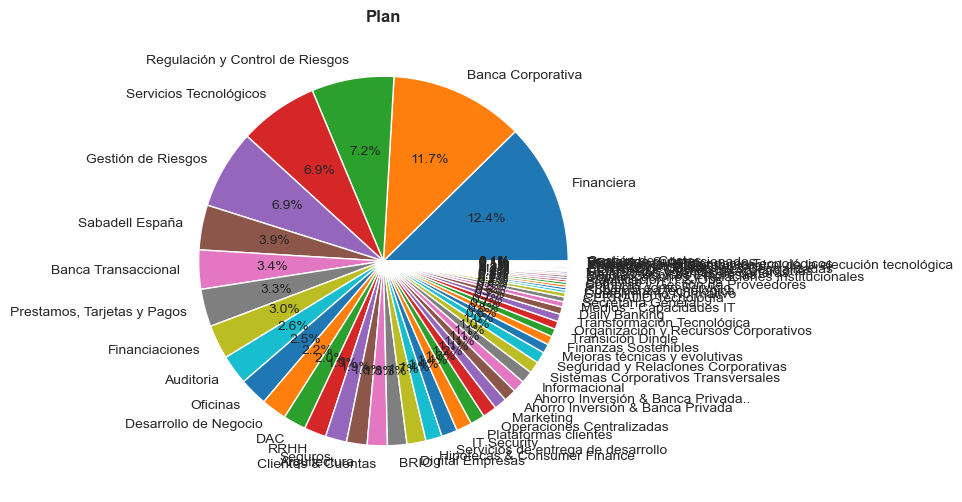

In [11]:
sns.set_style("whitegrid")
plt.figure(figsize=(8,6))
plt.pie(tabla_plan.values, labels=tabla_plan.index, autopct='%1.1f%%')
plt.title("Plan", fontweight='bold')
plt.show()

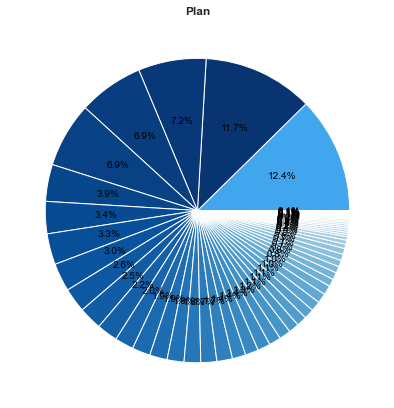

In [52]:
# new graph
colors = sns.color_palette("Blues_r", len(tabla_plan.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(tabla_plan.values, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Plan", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_plan.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)
plt.savefig("plan.png", dpi=300)
plt.show()


### 2.3 Dominio

In [28]:
tabla_dominio = data["Dominio"].value_counts()
print(tabla_dominio)
len(tabla_dominio)

Gestión de Riesgos                                              192
C&IB - Desarrollos Regulatorios                                 161
Financial Reporting & Control                                   152
Cumplimiento                                                    141
Production                                                      135
Datos                                                           131
C&IB - Negocios                                                 100
Normativo                                                        88
BRIO II                                                          86
Gestión Financiera y Oper.Corporativas                           76
Producto                                                         74
C&IB - Cross Programs                                            72
Customer Solutions                                               71
Desarrollo de negocio                                            67
Productividad Comercial                         

146

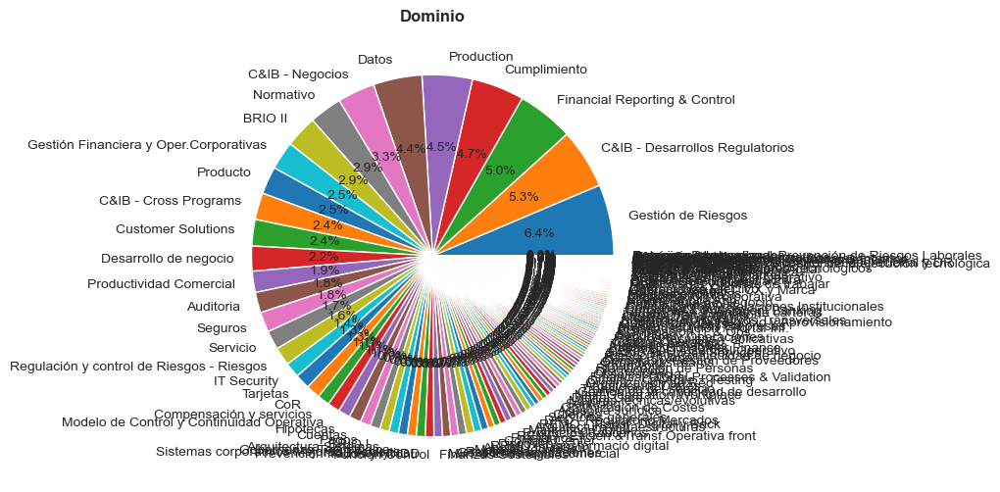

In [13]:
sns.set_style("whitegrid")
plt.figure(figsize=(8,6))
plt.pie(tabla_dominio.values, labels=tabla_dominio.index, autopct='%1.1f%%')
plt.title("Dominio", fontweight='bold')
plt.show()

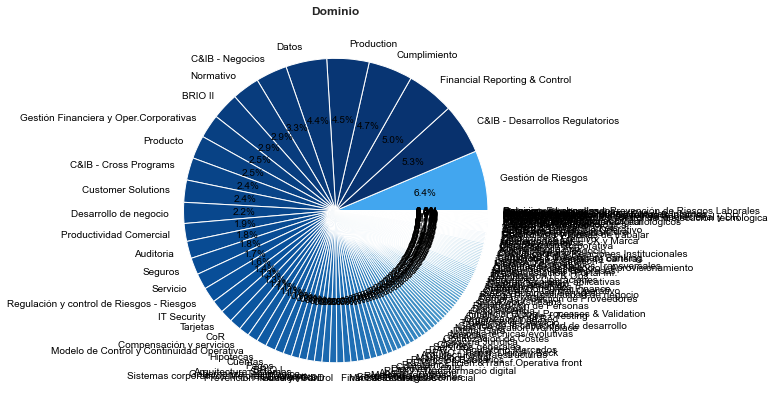

In [50]:
# new graph
colors = sns.color_palette("Blues_r", len(tabla_dominio.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(tabla_dominio.values, labels=tabla_dominio.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Dominio", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_dominio.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)
plt.savefig("dominio.png", dpi=300)
plt.show()

### 2.4 Programa

In [39]:
tabla_programa = data["Programa"].value_counts()
print(tabla_programa)

PG-148, C&IB Desarrollos Regulatorios                                            75
PG-12, Desarrollo de negocio                                                     67
PG-168, Evolución y mejora de las capacidades en el ámbito de AML                56
PG-345, Evolución Negocio C&IB                                                   54
PG-385, Mejoras aplicativas Financiera                                           45
PG-187, Gobierno de datos                                                        43
PG-77, Financial Reporting & Control                                             40
PG-309, Mejoras aplicativas Gestión de Riesgos                                   40
PG-664, Regulación Tesorería                                                     39
PG-517, Emisión                                                                  37
PG-163, Evolución sistemas Auditoria Interna                                     35
PG-292, Capital & Impairments                                               

In [15]:
len(tabla_programa)

480

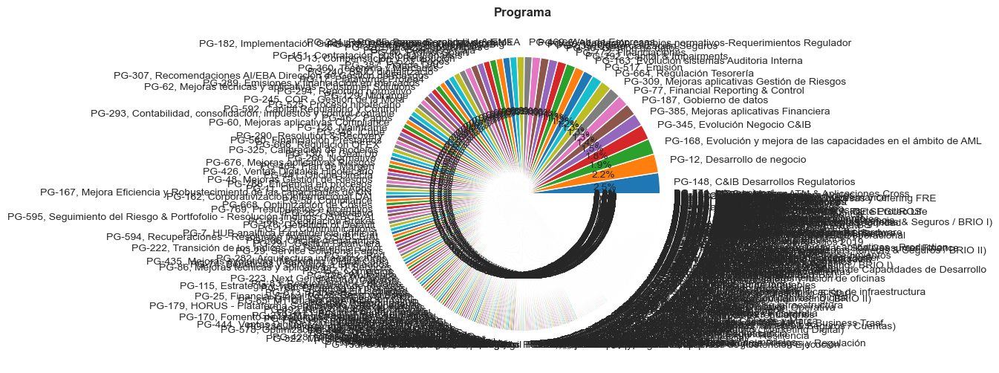

In [16]:
sns.set_style("whitegrid")
plt.figure(figsize=(8,6))
plt.pie(tabla_programa.values, labels=tabla_programa.index, autopct='%1.1f%%')
plt.title("Programa", fontweight='bold')
plt.show()

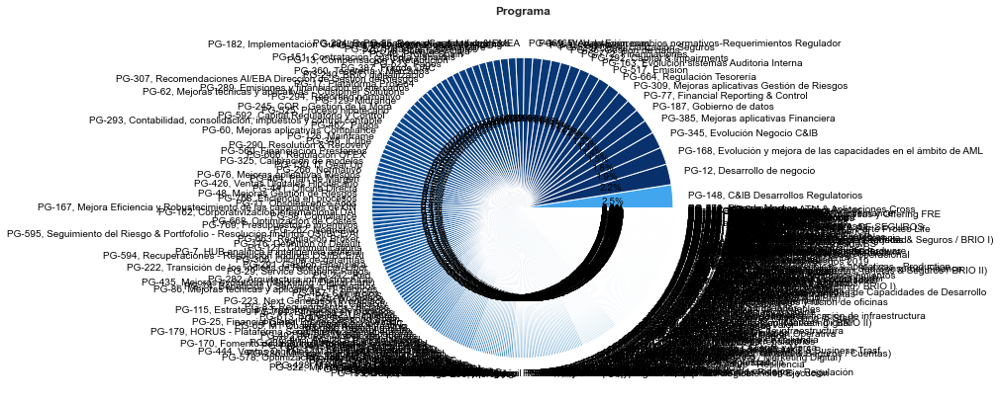

In [51]:
# new graph
colors = sns.color_palette("Blues_r", len(tabla_programa.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(tabla_programa.values, labels=tabla_programa.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Programa", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_programa.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)
plt.savefig("programa.png", dpi=300)
plt.show()

In [57]:
print(data["Agrupación IT Demanda"].isna().sum())
print(data["Plan"].isna().sum())
print(data["Dominio"].isna().sum())
print(data["Programa"].isna().sum())

0
0
0
0


### 2.5 Gestor Demanda

In [17]:
data['Gestor Demanda'].isna().sum()

0

In [59]:
len(data['Gestor Demanda'].unique())

145

In [61]:
tabla_gestor = data["Gestor Demanda"].value_counts()
print(tabla_gestor)
CARLOS GUILLERMO PONCE JOY            159
JOSE ISAAC OSORIO TORRON              136
SERGIO ORTUÑO ACEDO                   131
MERCEDES CALVO CARNERO                121
BERNAT PRADES ALGUERO                 118
MARIA GLORIA PILA DIEZ                108
FERNANDO ROBLES CARMONA                91
ENRIC BUXERES SOLER                    90
ANNA FARRAN VALLS                      88
EDGAR MAYO DOMENECH                    87
JORDI LOPEZ ALMAZAN                    85
DAVID GARCIA SANJUAN                   76
PAULA ALVAREZ FERNANDEZ                76
JANA LARA PARDO                        76
ALESANDER GOMEZ DEHESA                 69
JOAQUIN JORGE CHUAN MONTES             60
JUAN ALIART RIVA                       59
DANIEL FERNANDEZ PISONERO              47
ROBERTO RUBIO BECARES                  46
JORDI PETCHAME SALA                    45
JOSEP COMAS PEÑALVER                   41
JOSE MARIA FARRE LEON                  39
MARIA DEL MAR LLORENS MIRO             39
MONTSERRAT DOMINGUEZ GARCIA            38
ORIOL PARCERISA MARTINEZ               36
JORGE GALAN GOMEZ                      34
JOAN PUIG GUITART                      34
JULIAN ALVEAR FUNES                    33
MIQUEL CALDERON REVUELTA               29
CESAR PABLO BRAVO MORATINOS            29
JUAN MANUEL CID ALFAGEME               28
JOAN SALAT MARTINEZ                    27
GEMMA LAMPLE CAMPAROLAS                27
ALBA ROIG NAVARRO                      26
MARIANA SOLEDAD CARABALLO GONZALEZ     25
NURIA GALLARDO MAGDALENO               24
FRANCISCO-JAVIER FABREGA AYMAR         23
ANGEL NAVARRO ESTEPA                   23
A646663                                22
FELIPE LOPEZ PORCEL                    20
IRIS MORENO VERDUGO                    19
GUSTAVO GARCIA TOME                    18
B985850                                18
JOSE JUAN MARTINEZ AUÑON               17
MARIA LOPEZ BENVENUTY                  17
IÑAKI GIL MORALES                      17
MARIA DE LA ROCA SAVALL PUJOL          15
VICTORIA CLIMENT FENOLLAR              15
VICTOR CUERVO PALENCIA                 15
JOSE-MANUEL SILLERO PADILLA            15
MARIA ANGELES YEBRA SERRANO            14
Q044724                                14
CARLOS LAGRU MOLINA                    14
JULIO ALVAREZ PENA                     13
XAVIER GOMEZ ALIBES                    13
MARIA VEIGA CALVO                      13
JUAN SEBASTIAN SILVA PEREZ             13
ALBERTO EGEA AVILA                     12
ANNA CAMAS RIPOLL                      12
DAVID CASAS LOPEZ                      12
ANTONY CHARLIE MEDINA GUILLEN          11
FABIOLA VANESSA NASCA MORENO           11
F879306                                10
RICARDO GOMEZ ISACH                    10
ORIOL GONZALEZ LLOBET                  10
RAFAEL JIMENEZ PEREZ                    9
ELISENDA ROYO BUJ                       9
SARA DOMINGUEZ BERMUDEZ                 9
SANTIAGO DIMITRI DE PEDRO OLABARRI      9
JAIME VIVES BASSAS                      8
CARLOS ANTONIO SESEÑA ATIENZA           8
ANTONIO JUAN LIEBANA VERGARA            8
IVAN GRANADOS HEREDIA                   8
CAROLINA GARCIA RODRIGUEZ               8
MARCOS GRIERA MONTLLO                   8
ROSA EVA MANDLER DEL ALAMO              7
X481938                                 7
IÑIGO LIDON GALARRAGA                   7
ADOLFO HERNANDEZ LORENTE                7
FELIPE GARCIA MAGAZ                     7
PEDRO CANTALEJO LEON                    7
E971234                                 7
JUAN-TOMAS BARRIONUEVO MARTINEZ         7
XAVIER SANCHEZ LISTAN                   7
JOSE IGNACIO PEREZ MOYA                 6
Q070208                                 6
PAULA IRENE SALGADO GONZALEZ            6
MIGUEL ANGEL SORIANO SANCHEZ            5
BUENAVENTURA FABREGO CANO               5
JUAN CARLOS SANCHEZ BRIANZO             5
JOAN FONT RIBAS                         5
JAUME MONRAS LOPEZ DE OCARIZ            5
JOSEP-RAMON SILVESTRE CLEMENTE          4
MIQUEL CODINA FARRIOL                   4
MIRIAM CRISTINA CASTAÑEDA PANDURO       4
IÑIGO RANEDO SANTILLANA                 4
DANIEL ROS HERNANDEZ                    4
JORDI BARRETO RAMON                     4
CARLOS GOMEZ RAMOS                      4
B458068                                 4
B322873                                 4
W972950                                 3
JOSE LUIS ALIAGA HURTADO                3
LAIA PORCAR GRAU                        3
TOMAS GIMENO LAZARO                     3
OLGA OLIVER VIDAL                       3
JOSE PARRA DE LA CRUZ                   3
MARTA LABIANO JUANENA                   3
J419315                                 2
D337741                                 2
V220541                                 2
SERGIO CONCA NAVARRO                    2
ESTER GIJON JAEN                        2
SAMUEL JOSE GONZALEZ GARCIA             2
JOSE IGNACIO DE MIGUEL GONZALEZ         2
OLGA PATRICIA RUERA BRAVO               2
SERGIO MORALES SAEZ                     2
ANNA CASAS TORTOSA                      2
ANGEL CARRETON CASADO                   2
GEMMA PUIG MORRAL                       2
JUAN DALMAU GAMARRA                     2
NERINA BERMUDO PLA                      1
ANTONIO JURADO PEREZ                    1
VICTOR JOSE YUBERO GIBANEL              1
ANNA CABALLERIA NUÑEZ                   1
K156762                                 1
W801555                                 1
Z750767                                 1
RAQUEL CALVO OLMOS                      1
JOSE MARIA STANI SANCHEZ                1
E149202                                 1
C398834                                 1
MANUEL SANCHEZ SECADES                  1
SERGI UCEDA HERNANDEZ                   1
SARA DEFLAOUI LAMOUIFI                  1
ALBERTO PRADES PIÑA                     1
DAVID DELGADO QUESADA                   1
JESUS SANCHEZ GARCIA                    1
B743586                                 1
SHEILA MEDINA TORRES                    1
V655770                                 1
NATALIA DOMINGO LLORENS                 1
JAVIER TORIBIO HERNANSANZ               1
GERARD FRANCESC ESCRIBA GELONCH         1
F736056                                 1

CARLOS GUILLERMO PONCE JOY            159
JOSE ISAAC OSORIO TORRON              136
SERGIO ORTUÑO ACEDO                   131
MERCEDES CALVO CARNERO                121
BERNAT PRADES ALGUERO                 118
MARIA GLORIA PILA DIEZ                108
FERNANDO ROBLES CARMONA                91
ENRIC BUXERES SOLER                    90
ANNA FARRAN VALLS                      88
EDGAR MAYO DOMENECH                    87
JORDI LOPEZ ALMAZAN                    85
DAVID GARCIA SANJUAN                   76
PAULA ALVAREZ FERNANDEZ                76
JANA LARA PARDO                        76
ALESANDER GOMEZ DEHESA                 69
JOAQUIN JORGE CHUAN MONTES             60
JUAN ALIART RIVA                       59
DANIEL FERNANDEZ PISONERO              47
ROBERTO RUBIO BECARES                  46
JORDI PETCHAME SALA                    45
JOSEP COMAS PEÑALVER                   41
JOSE MARIA FARRE LEON                  39
MARIA DEL MAR LLORENS MIRO             39
MONTSERRAT DOMINGUEZ GARCIA       

In [65]:
top_10_gestor = tabla_gestor[0:14]
top_10_gestor
CARLOS GUILLERMO PONCE JOY    159
JOSE ISAAC OSORIO TORRON      136
SERGIO ORTUÑO ACEDO           131
MERCEDES CALVO CARNERO        121
BERNAT PRADES ALGUERO         118
MARIA GLORIA PILA DIEZ        108
FERNANDO ROBLES CARMONA        91
ENRIC BUXERES SOLER            90
ANNA FARRAN VALLS              88
EDGAR MAYO DOMENECH            87
JORDI LOPEZ ALMAZAN            85
DAVID GARCIA SANJUAN           76
PAULA ALVAREZ FERNANDEZ        76
JANA LARA PARDO                76

CARLOS GUILLERMO PONCE JOY    159
JOSE ISAAC OSORIO TORRON      136
SERGIO ORTUÑO ACEDO           131
MERCEDES CALVO CARNERO        121
BERNAT PRADES ALGUERO         118
MARIA GLORIA PILA DIEZ        108
FERNANDO ROBLES CARMONA        91
ENRIC BUXERES SOLER            90
ANNA FARRAN VALLS              88
EDGAR MAYO DOMENECH            87
JORDI LOPEZ ALMAZAN            85
DAVID GARCIA SANJUAN           76
PAULA ALVAREZ FERNANDEZ        76
JANA LARA PARDO                76
Name: Gestor Demanda, dtype: int64

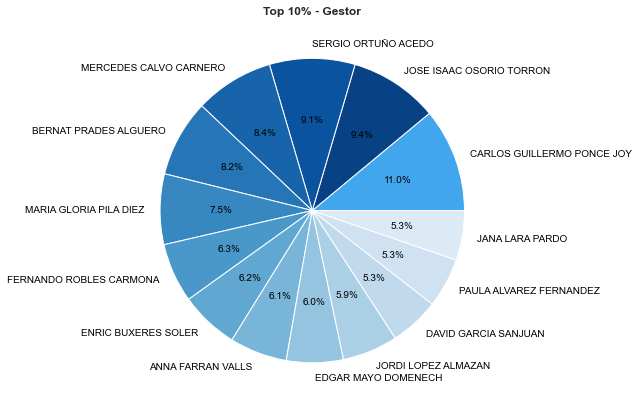

In [69]:

colors = sns.color_palette("Blues_r", len(top_10_gestor.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(top_10_gestor.values, labels=top_10_gestor.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Top 10% - Gestor", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_programa.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)
plt.savefig("gestor.png", dpi=300)
plt.show()

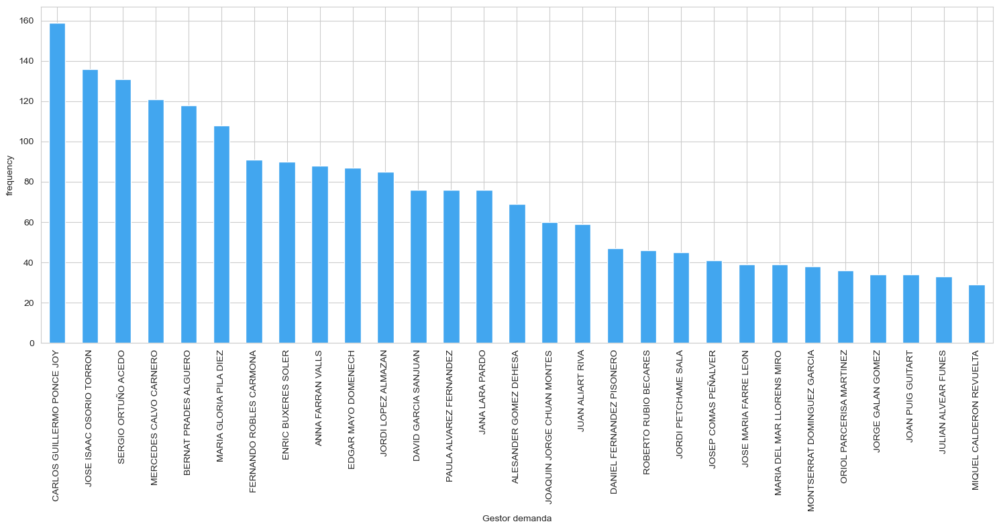

In [19]:
plt.rcParams["figure.figsize"] = [15, 8]
plt.rcParams["figure.autolayout"] = True

fig, ax = plt.subplots()

# plot top 20% "Gestor Demanda"
data['Gestor Demanda'].value_counts()[0:29].plot(ax=ax, kind='bar', xlabel='Gestor demanda', ylabel='frequency',  color='#42A6EF')

plt.show()

### 2.6 Unidad IT

In [ ]:
6069 - Data Solutions                                               89
8903 - Gestión de Proyectos Banca Transaccional                     85
6069 - Data Output                                                  77
4430 - Digital Solutions                                            71
8820 - Gestión de Proyectos Data Centric                            68
7618 - Gestión Integral del Coste                                   66
8982 - Gestión de Proyectos Banca Corporativa                       64
7614 - Finanzas                                                     64
5164 - Proyectos Analíticos                                         56
8865 - Gestión de Proyectos Finanzas, RRHH y Legal, Tax & Cross     55
6351 - Pagos                                                        45
7811 - Gestión y Control de Riesgos                                 39
6374 - Tesorería, Riesgos y OFEX                                    39
6354 - Tarjetas                                                     36
7488 - Gestión de proyectos                                         36
7559 - Activo y Pasivo                                              33
4439 - Digital Delivery - PMO Office                                27
9608 - Proyectos de IT y Operaciones                                26
4431 - Desarrollo Digital                                           26
6066 - Financial Reporting & Control                                25
6260 - Back Office Mercados                                         25
6065 - Financial Management Apps                                    24
7997 - Data Solutions                                               23
6351 - Payments                                                     22
4439 - Proyectos Digitales Empresas                                 22
5442 - Medios de Pago                                               22
8424 - RRHH                                                         21
6354 - Cards                                                        21
6086 - Aplicaciones de gestión de riesgos                           20
7833 - Seguros                                                      19
6052 - Accounts & Customer Data                                     18
6053 - Working Capital                                              18
7811 - Riesgos                                                      18
6756 - Gestión de Seguridad Tecnológica                             18
5881 - Gestión de Activos Irregulares                               18
6162 - MIFID, Auditoría y Seguridad                                 18
8658 - Centro Especialista Ventas, oficinas y aplicaciones Cross    17
7812 - Compliance & Audit Apps                                      17
6042 - Préstamos, créditos, garantías, avales                       17
6210 - Cross Apps (Medios)                                          17
7806 - Data Governance                                              17
6086 - Risks Management Apps                                        17

In [20]:
data['Unidad IT'].isna().sum()

4

In [121]:
table_uni = data['Unidad IT'].value_counts()
len(table_uni)
top_10_uni = table_uni[0:42]
top_10_uni

6069 - Data Solutions                                               89
8903 - Gestión de Proyectos Banca Transaccional                     85
6069 - Data Output                                                  77
4430 - Digital Solutions                                            71
8820 - Gestión de Proyectos Data Centric                            68
7618 - Gestión Integral del Coste                                   66
8982 - Gestión de Proyectos Banca Corporativa                       64
7614 - Finanzas                                                     64
5164 - Proyectos Analíticos                                         56
8865 - Gestión de Proyectos Finanzas, RRHH y Legal, Tax & Cross     55
6351 - Pagos                                                        45
7811 - Gestión y Control de Riesgos                                 39
6374 - Tesorería, Riesgos y OFEX                                    39
6354 - Tarjetas                                                     36
7488 -

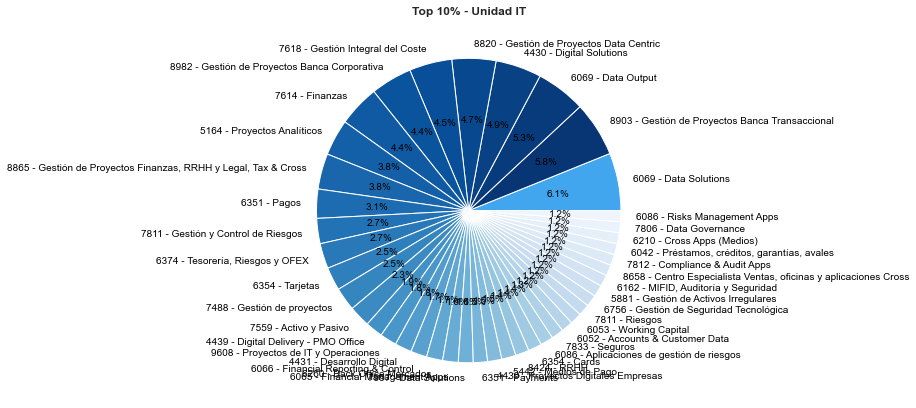

In [134]:
colors = sns.color_palette("Blues_r", len(top_10_uni.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(top_10_uni.values, labels=top_10_uni.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Top 10% - Unidad IT", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_programa.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)
plt.savefig("uni.png", dpi=300)
plt.show()

In [58]:
data['Unidad IT'].value_counts() # Some values differ in code but not text !! Meaning???

6069 - Data Solutions                                                89
8903 - Gestión de Proyectos Banca Transaccional                      85
6069 - Data Output                                                   77
4430 - Digital Solutions                                             71
8820 - Gestión de Proyectos Data Centric                             68
7618 - Gestión Integral del Coste                                    66
8982 - Gestión de Proyectos Banca Corporativa                        64
7614 - Finanzas                                                      64
5164 - Proyectos Analíticos                                          56
8865 - Gestión de Proyectos Finanzas, RRHH y Legal, Tax & Cross      55
6351 - Pagos                                                         45
7811 - Gestión y Control de Riesgos                                  39
6374 - Tesorería, Riesgos y OFEX                                     39
6354 - Tarjetas                                                 

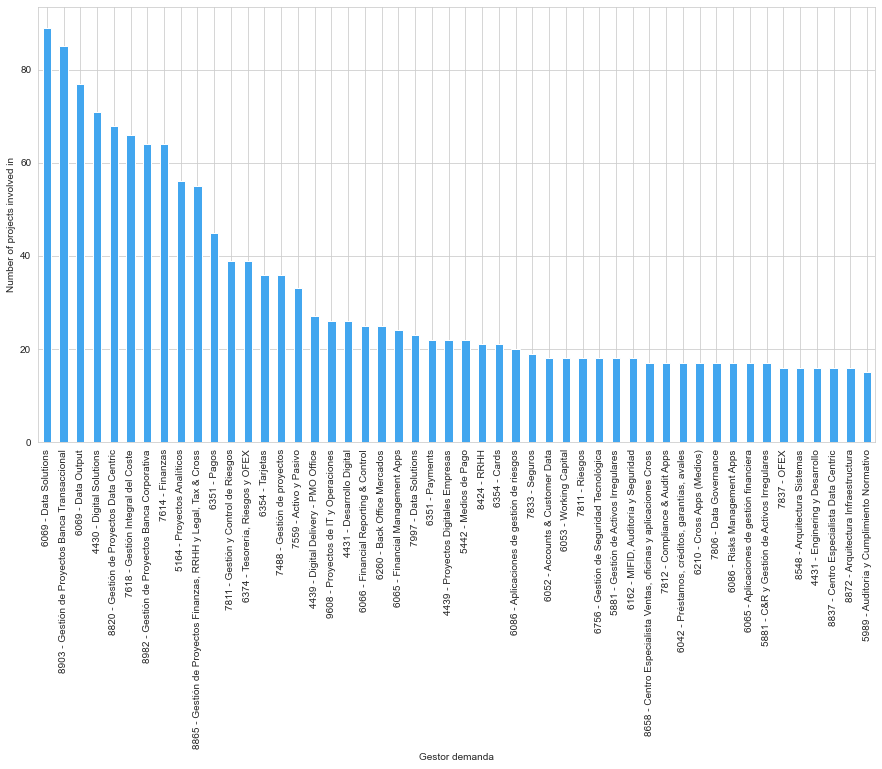

In [80]:
plt.rcParams["figure.figsize"] = [15, 8]
plt.rcParams["figure.autolayout"] = False

fig, ax = plt.subplots()

data['Unidad IT'].value_counts()[0:50].plot(ax=ax, kind='bar', xlabel='Gestor demanda', ylabel='Number of projects involved in',  color='#42A6EF')

plt.show()

### 2.7 IT Manager

In [24]:
# Group the dataframe by name and count the frequency of each name
it_manager_freq = data.groupby(['IT Manager']).size().reset_index(name='Frequency_IT_Manager')
len(it_manager_freq)

407

In [25]:
it_manager_freq_sorted = it_manager_freq.sort_values(by = 'Frequency_IT_Manager', ascending=False)
pd.set_option('display.max_rows', None)
it_manager_freq_sorted

,IT Manager,Frequency_IT_Manager
330,NURIA GALLARDO MAGDALENO,97
171,JESUS SANCHEZ GARCIA,76
188,JORGE HUERTA ANTON,57
316,MONICA PEREZ RAMOS,56
36,ANGEL NAVARRO ESTEPA,54
14,ALBERTO RUIZ RODRIGUEZ,54
140,GASPAR GONZALEZ VARA,49
186,JORDI PETCHAME SALA,47
337,PATRICIA CARRASCO AYORA,45
373,SARA DOMINGUEZ BERMUDEZ,44


NURIA GALLARDO MAGDALENO                         97
JESUS SANCHEZ GARCIA                             76
JORGE HUERTA ANTON                               57
MONICA PEREZ RAMOS                               56
ANGEL NAVARRO ESTEPA                             54
ALBERTO RUIZ RODRIGUEZ                           54
GASPAR GONZALEZ VARA                             49
JORDI PETCHAME SALA                              47
PATRICIA CARRASCO AYORA                          45
JOSE LUIS ALIAGA HURTADO                         44
SARA DOMINGUEZ BERMUDEZ                          44
ENRIC SALVADOR ARIAS                             43
JULIAN ALVEAR FUNES                              39
MONTSERRAT DOMINGUEZ GARCIA                      38
JORGE VERDUGO ROMERO                             38
JUAN ALIART RIVA                                 35
ANDREA LLOPIS RICO                               34
SERGIO NETO VAN TRIKT                            31
MIQUEL CALDERON REVUELTA                         29
SANTIAGO ARI

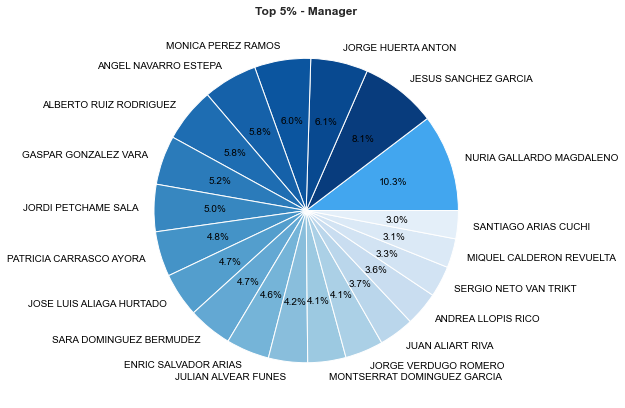

In [76]:
colors = sns.color_palette("Blues_r", len(top_10_manager.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(top_10_manager.values, labels=top_10_manager.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Top 5% - Manager", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_programa.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)
plt.savefig("manager.png", dpi=300)
plt.show()

### 2.8 Business Owner

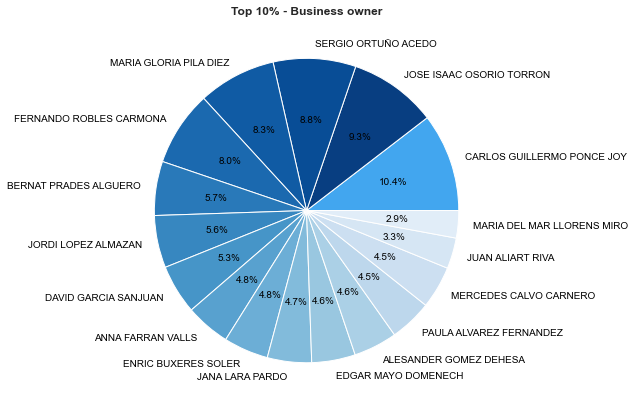

In [78]:
tabla_owner = data["Business Owner"].value_counts()
top_10_owner = tabla_owner[0:17]
colors = sns.color_palette("Blues_r", len(top_10_owner.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(top_10_owner.values, labels=top_10_owner.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Top 10% - Business owner", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_programa.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)

plt.savefig("owner.png", dpi=300)
plt.show()

In [26]:
business_owner_freq = data.groupby(['Business Owner']).size().reset_index(name='Frequency_Business_Owner')
len(business_owner_freq)

169

In [27]:
business_owner_freq_sorted = business_owner_freq.sort_values(by = 'Frequency_Business_Owner', ascending=False)
pd.set_option('display.max_rows', None)
business_owner_freq_sorted

,Business Owner,Frequency_Business_Owner
33,CARLOS GUILLERMO PONCE JOY,169
89,JOSE ISAAC OSORIO TORRON,151
153,SERGIO ORTUÑO ACEDO,142
112,MARIA GLORIA PILA DIEZ,134
59,FERNANDO ROBLES CARMONA,129
28,BERNAT PRADES ALGUERO,93
83,JORDI LOPEZ ALMAZAN,90
41,DAVID GARCIA SANJUAN,85
16,ANNA FARRAN VALLS,77
48,ENRIC BUXERES SOLER,77


### 2.9 Comparing both together

In [28]:
df = data[['IT Manager','Business Owner']]
df

,IT Manager,Business Owner
0,FRANCISCO JAVIER COBO GARCIA,JOSE ISAAC OSORIO TORRON
3,JOSE LUIS ALIAGA HURTADO,BERNAT PRADES ALGUERO
6,JANA LARA PARDO,JANA LARA PARDO
9,"TRILLES PANE, ANNA",MARIA DEL MAR LLORENS MIRO
12,ANDREA LLOPIS RICO,BERNAT PRADES ALGUERO
15,JOSE IGNACIO DE MIGUEL GONZALEZ,MARIA VEIGA CALVO
18,MERCEDES GARCIA PARDO,MARIA LOPEZ BENVENUTY
21,JOSE LUIS ALIAGA HURTADO,BERNAT PRADES ALGUERO
24,ALBERTO RUIZ RODRIGUEZ,MARIA DEL MAR LLORENS MIRO
27,JOSE LUIS ALIAGA HURTADO,BERNAT PRADES ALGUERO


In [29]:
# Merge the frequency dataframe back into the original dataframe
df_freq = pd.merge(df, it_manager_freq, on='IT Manager')
df_freq = pd.merge(df_freq, business_owner_freq, on='Business Owner')
df_freq

,IT Manager,Business Owner,Frequency_IT_Manager,Frequency_Business_Owner
0,FRANCISCO JAVIER COBO GARCIA,JOSE ISAAC OSORIO TORRON,16,151
1,FRANCISCO JAVIER COBO GARCIA,JOSE ISAAC OSORIO TORRON,16,151
2,FRANCISCO JAVIER COBO GARCIA,JOSE ISAAC OSORIO TORRON,16,151
3,FRANCISCO JAVIER COBO GARCIA,JOSE ISAAC OSORIO TORRON,16,151
4,JOSE LUIS ALIAGA HURTADO,JOSE ISAAC OSORIO TORRON,44,151
5,JOSE LUIS ALIAGA HURTADO,JOSE ISAAC OSORIO TORRON,44,151
6,JOSE LUIS ALIAGA HURTADO,JOSE ISAAC OSORIO TORRON,44,151
7,JOSE LUIS ALIAGA HURTADO,JOSE ISAAC OSORIO TORRON,44,151
8,JOSE LUIS ALIAGA HURTADO,JOSE ISAAC OSORIO TORRON,44,151
9,JOSE LUIS ALIAGA HURTADO,JOSE ISAAC OSORIO TORRON,44,151


In [30]:
df_freq['IT=BO'] = df_freq['IT Manager'] == df_freq['Business Owner']
df_freq['IT=BO'].value_counts()

False    2511
True      499
Name: IT=BO, dtype: int64

In [31]:
df_freq[df_freq['IT=BO']== True]

,IT Manager,Business Owner,Frequency_IT_Manager,Frequency_Business_Owner,IT=BO
240,BERNAT PRADES ALGUERO,BERNAT PRADES ALGUERO,7,93,True
241,BERNAT PRADES ALGUERO,BERNAT PRADES ALGUERO,7,93,True
244,FRANCISCO JAVIER COBO GARCIA,FRANCISCO JAVIER COBO GARCIA,16,9,True
245,FRANCISCO JAVIER COBO GARCIA,FRANCISCO JAVIER COBO GARCIA,16,9,True
246,FRANCISCO JAVIER COBO GARCIA,FRANCISCO JAVIER COBO GARCIA,16,9,True
247,FRANCISCO JAVIER COBO GARCIA,FRANCISCO JAVIER COBO GARCIA,16,9,True
248,FRANCISCO JAVIER COBO GARCIA,FRANCISCO JAVIER COBO GARCIA,16,9,True
249,FRANCISCO JAVIER COBO GARCIA,FRANCISCO JAVIER COBO GARCIA,16,9,True
250,FRANCISCO JAVIER COBO GARCIA,FRANCISCO JAVIER COBO GARCIA,16,9,True
251,FRANCISCO JAVIER COBO GARCIA,FRANCISCO JAVIER COBO GARCIA,16,9,True


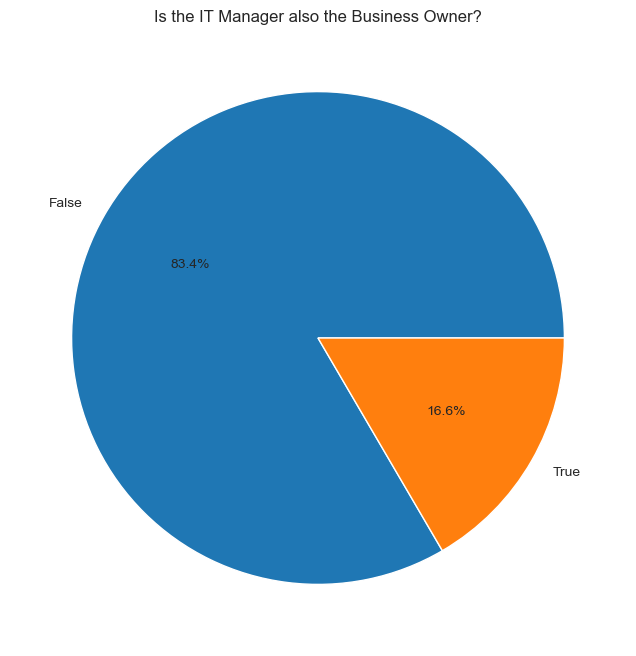

In [32]:
plt.pie(df_freq['IT=BO'].value_counts(), labels=df_freq['IT=BO'].value_counts().index, autopct='%1.1f%%')
plt.title('Is the IT Manager also the Business Owner?')
plt.show()

### 2.10 Agrupación IT de Ejecución

In [33]:
data['Agrupación IT de Ejecución'].isnull().sum()

631

In [130]:
aie = data['Agrupación IT de Ejecución'].value_counts()
#len(aie)
top_20_aie = aie[0:10]
top_20_aie

SERVICIOS DE ENTREGA DE DESARROLLO                  1412
GESTIÓN DE APLICACIONES                              297
INNOCELLS                                            176
SERVICIOS TECNOLÓGICOS                                97
TECNOLOGÍA                                            58
SISTEMAS CORPORATIVOS                                 46
BANCA TRANSACCIONAL                                   40
DIRECCIÓN DE TECNOLOGÍA                               38
OPERACIONES Y TECNOLOGÍA BANCA CORPORATIVA            27
DIRECCIÓN ORGANIZACIÓN GLOBAL Y PROYECTOS CORPOR      25
Name: Agrupación IT de Ejecución, dtype: int64

In [131]:
aie
SERVICIOS DE ENTREGA DE DESARROLLO                  1412
GESTIÓN DE APLICACIONES                              297
INNOCELLS                                            176
SERVICIOS TECNOLÓGICOS                                97
TECNOLOGÍA                                            58
SISTEMAS CORPORATIVOS                                 46
BANCA TRANSACCIONAL                                   40
DIRECCIÓN DE TECNOLOGÍA                               38
OPERACIONES Y TECNOLOGÍA BANCA CORPORATIVA            27
DIRECCIÓN ORGANIZACIÓN GLOBAL Y PROYECTOS CORPOR      25
ORGANIZACIÓN Y PROYECTOS CORPORATIVOS                 20
PRODUCCIÓN                                            19
OPERACIONES Y TECNOLOGÍA EMPRESAS Y RED               12
MARKETING Y VENTAS                                    10
CIO PROYECTOS DATOS Y SISTEMAS CORPORATIVOS            9
TESORERÍA Y MERCADOS                                   8
TRANSFORMACIÓN TECNOLÓGICA                             7
RIESGO, AUDITORÍA Y CUMPLIMIENTO                       6
SUCURSALES, ATMS & APLICACIONES CROSS                  6
INGENIERÍA DATOS                                       6
CONTRATACIÓN, FINANZAS Y CONTROL DE LA EJECUCIÓN       5
INFRAESTRUCTURAS TECNOLÓGICAS                          5
CIO PROYECTOS CORE BANCARIO                            5
CIO PROYECTOS CORPORATE & INVESTMENT BANKING           4
OPERACIONES Y TECNOLOGÍA PARTICULARES                  4
PROYECTOS DE INFRAESTRUCTURA Y PRODUCCIÓN TSB          3
CIO DATOS Y SISTEMAS CORPORATIVOS                      3
DIRECCIÓN DE SISTEMAS CORPORATIVOS                     3
PUESTO DE TRABAJO                                      3
ANALÍTICA E INTELIGENCIA ARTIFICIAL                    3
CIO CORE BANCARIO                                      3
MIDDLEWARE Y BASE DE DATOS                             3
CIO CORPORATE & INVESTMENT BANKING                     2
EFICIENCIA Y PROYECTOS CORPORATIVOS                    2
SERVICIOS DE CLIENTES                                  2
OTROS CLIENTES & OFEX                                  2
Infraestructuras Tecnológicas                          2
Production                                             1
CONTROL DE SERVICIO Y EXPLOTACIÓN                      1
SEGURIDAD OPERATIVA                                    1
SABIS                                                  1
PLANIFICACIÓN IT&OPS                                   1
Technological Transformation                           1

SERVICIOS DE ENTREGA DE DESARROLLO                  1412
GESTIÓN DE APLICACIONES                              297
INNOCELLS                                            176
SERVICIOS TECNOLÓGICOS                                97
TECNOLOGÍA                                            58
SISTEMAS CORPORATIVOS                                 46
BANCA TRANSACCIONAL                                   40
DIRECCIÓN DE TECNOLOGÍA                               38
OPERACIONES Y TECNOLOGÍA BANCA CORPORATIVA            27
DIRECCIÓN ORGANIZACIÓN GLOBAL Y PROYECTOS CORPOR      25
ORGANIZACIÓN Y PROYECTOS CORPORATIVOS                 20
PRODUCCIÓN                                            19
OPERACIONES Y TECNOLOGÍA EMPRESAS Y RED               12
MARKETING Y VENTAS                                    10
CIO PROYECTOS DATOS Y SISTEMAS CORPORATIVOS            9
TESORERÍA Y MERCADOS                                   8
TRANSFORMACIÓN TECNOLÓGICA                             7
RIESGO, AUDITORÍA Y CUMPLIMIENT

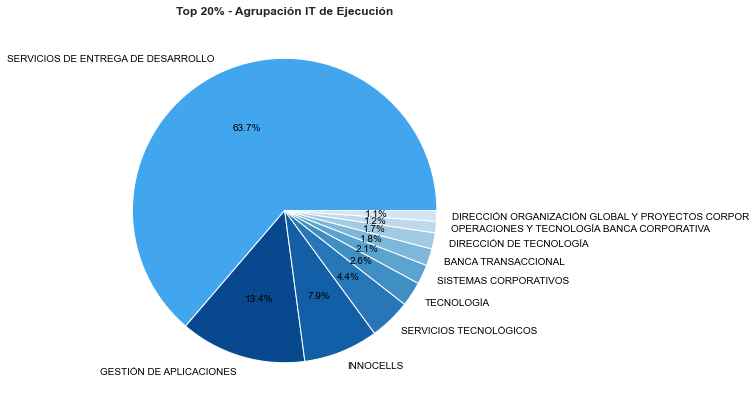

In [129]:

colors = sns.color_palette("Blues_r", len(top_20_aie.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(top_20_aie.values, labels=top_20_aie.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Top 20% - Agrupación IT de Ejecución", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_programa.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)

plt.savefig("aie.png", dpi=300)
plt.show()

In [109]:
top_20_aie.values

array([1412,  297,  176,   97,   58,   46,   40,   38,   27,   25])

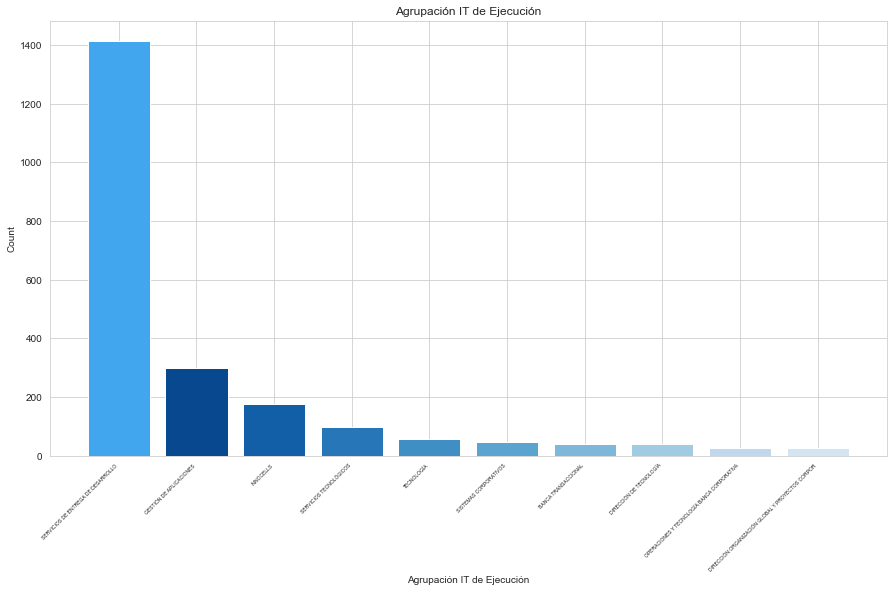

In [101]:
colors = sns.color_palette("Blues_r", len(top_20_aie.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

plt.bar(top_20_aie.index, top_20_aie.values,  color=color_map)

plt.xlabel('Agrupación IT de Ejecución')
plt.ylabel('Count')
plt.title('Agrupación IT de Ejecución')

plt.xticks(rotation=45, ha='right', fontsize=5)

plt.savefig("aie.png", dpi=300)
plt.show()

### 2.11 Área Peticionaria

In [133]:
9608 - Proyectos Banca Corporativa                                                   165
7994 - Financiera y Finanzas Sostenibles                                             163
7932 - Riesgos                                                                       146
7963 - Cumplimiento Normativo y Auditoria Interna                                    146
9031 - CIO Proyectos Datos y Sistemas Corporativos                                   141
8410                                                                                 125
4411                                                                                  90
4957 - Proyectos Banca Transaccional                                                  88
5599                                                                                  86
4947 - Proyectos Clientes, Cuentas, Daily Banking y Plataforma Clientes               85
7843                                                                                  84
4430 - Transformación Hipotecaria                                                     67
7618 - Gastos Generales                                                               65
4946 - Proyectos Financiación y MMPP, SCF, Seguros y Ahorro Inversión y Marketing     65
4364 - Gestión del Portfolio                                                          64
8889 - Sistemas Corporativos                                                          59
4425                                                                                  47
4439 - Proyectos Digitales Empresas                                                   46
7812                                                                                  43
7991                                                                                  37
7992 - Sistemas Corporativos Generales                                                35
9713 - Tesorería y Mercados                                                           34
6066                                                                                  32
5894 - Producto - Servicing                                                           32
8411 - Gestión de Proyectos                                                           31
8182 - Syndicate & Sales                                                              30

9608 - Proyectos Banca Corporativa                                                   165
7994 - Financiera y Finanzas Sostenibles                                             163
7932 - Riesgos                                                                       146
7963 - Cumplimiento Normativo y Auditoria Interna                                    146
9031 - CIO Proyectos Datos y Sistemas Corporativos                                   141
8410                                                                                 125
4411                                                                                  90
4957 - Proyectos Banca Transaccional                                                  88
5599                                                                                  86
4947 - Proyectos Clientes, Cuentas, Daily Banking y Plataforma Clientes               85
7843                                                                                  84
4430 - Transformación

In [104]:
## New approach
pet = data['Área Peticionaria'].value_counts()
len(pet)
top_10_pet = pet[0:26]
top_10_pet

9608 - Proyectos Banca Corporativa                                                   165
7994 - Financiera y Finanzas Sostenibles                                             163
7932 - Riesgos                                                                       146
7963 - Cumplimiento Normativo y Auditoria Interna                                    146
9031 - CIO Proyectos Datos y Sistemas Corporativos                                   141
8410                                                                                 125
4411                                                                                  90
4957 - Proyectos Banca Transaccional                                                  88
5599                                                                                  86
4947 - Proyectos Clientes, Cuentas, Daily Banking y Plataforma Clientes               85
7843                                                                                  84
4430 - Transformación

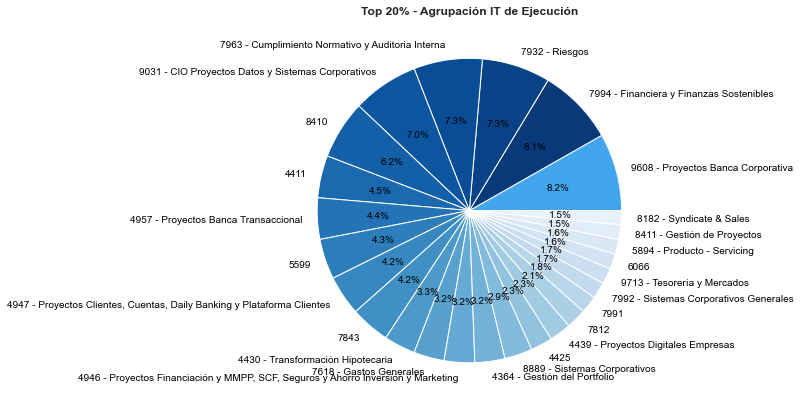

In [132]:
colors = sns.color_palette("Blues_r", len(top_10_pet.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]


sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(top_10_pet.values, labels=top_10_pet.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Top 20% - Agrupación IT de Ejecución", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_programa.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)

plt.savefig("pet.png", dpi=300)
plt.show()


## 3. Objetivo

In [81]:
data['Objetivo'].isnull().sum()

0

In [82]:
counts = data['Objetivo'].value_counts()
len(counts)

10

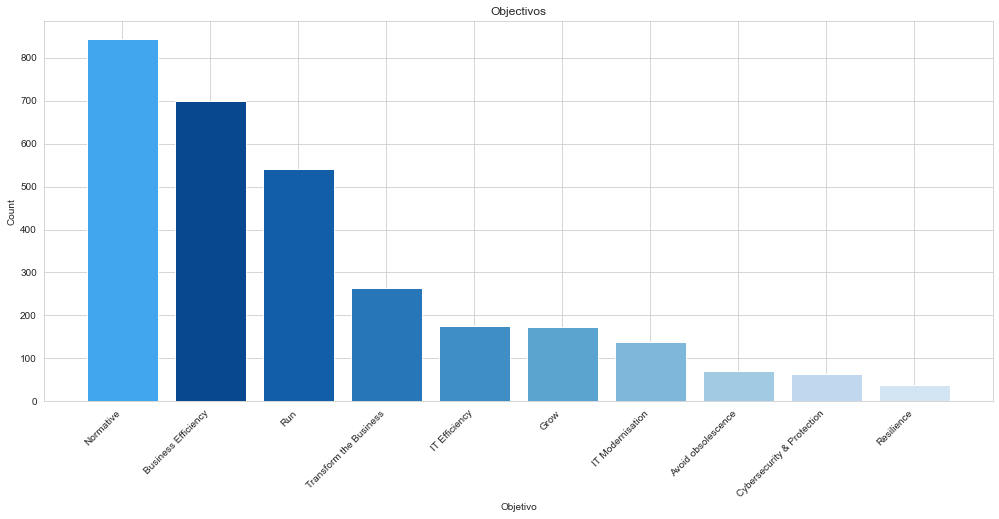

In [85]:
#Objetivo barchart 

counts = data['Objetivo'].value_counts()

colors = sns.color_palette("Blues_r", len(counts.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

#sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.bar(counts.index, counts.values, color=color_map)

plt.xlabel('Objetivo')
plt.ylabel('Count')
plt.title('Objectivos')

plt.xticks(rotation=45, ha='right')
plt.savefig("obj.png", dpi=300)

plt.show()

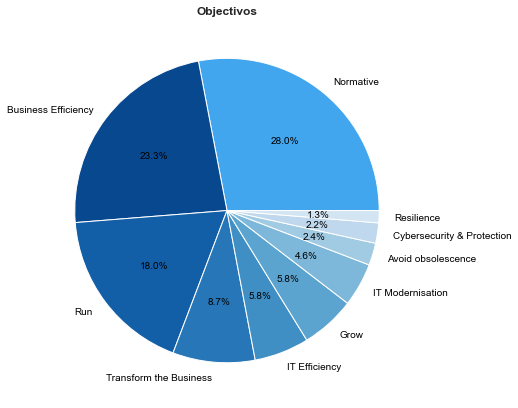

In [89]:
#Objetivo barchart 

counts = data['Objetivo'].value_counts()

colors = sns.color_palette("Blues_r", len(counts.index))
start_color = "#42A6EF"
color_map = [start_color] + colors[:len(colors)-1]

sns.set_style("whitegrid")
plt.figure(figsize=(17,7))
plt.pie(counts.values, labels=counts.index, autopct='%1.1f%%' , colors=color_map, textprops={'color':"black"})
plt.title("Objectivos", fontweight='bold')
#plt.legend(title="Labels", labels=tabla_programa.index, loc="center left", bbox_to_anchor=(1, 0.5),ncol=5)
plt.savefig("obj.png", dpi=300)
plt.show()


## 4. Dates exploration
### 4.1 Fecha inicio vs Fecha fin

In [124]:
# Filtering dates 

dates = data[['Fecha inicio','Fecha fin']]

In [125]:
# Creating a new columns for length of projects

dates['Time length'] = (dates['Fecha fin'] - dates['Fecha inicio']).dt.days.astype('int16')
dates.head()

,Fecha inicio,Fecha fin,Time length
0,2023-02-20,2023-07-31,161
3,2023-02-27,2023-05-31,93
6,2023-02-20,2023-08-31,192
9,2023-02-20,2023-07-17,147
12,2023-02-20,2023-05-31,100


In [45]:
# Checking missing values

dates.isna().sum()

Fecha inicio    0
Fecha fin       0
Time length     0
dtype: int64

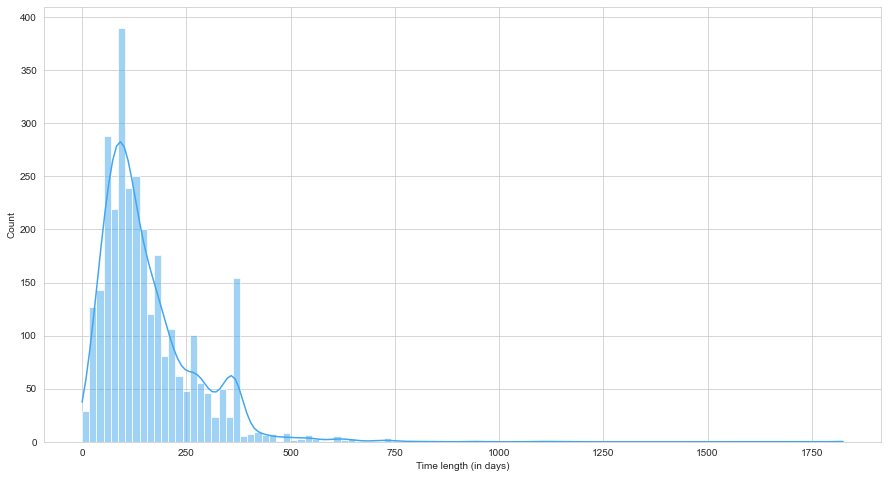

In [128]:
# Plotting project lengths

plt.figure(figsize=(15,8))
sns.histplot(x="Time length", data=dates, color='#42A6EF', kde=True)
plt.xlabel("Time length (in days)")
plt.ylabel("Count")
plt.savefig("len.png", dpi=300)


Text(0, 0.5, 'Time length')

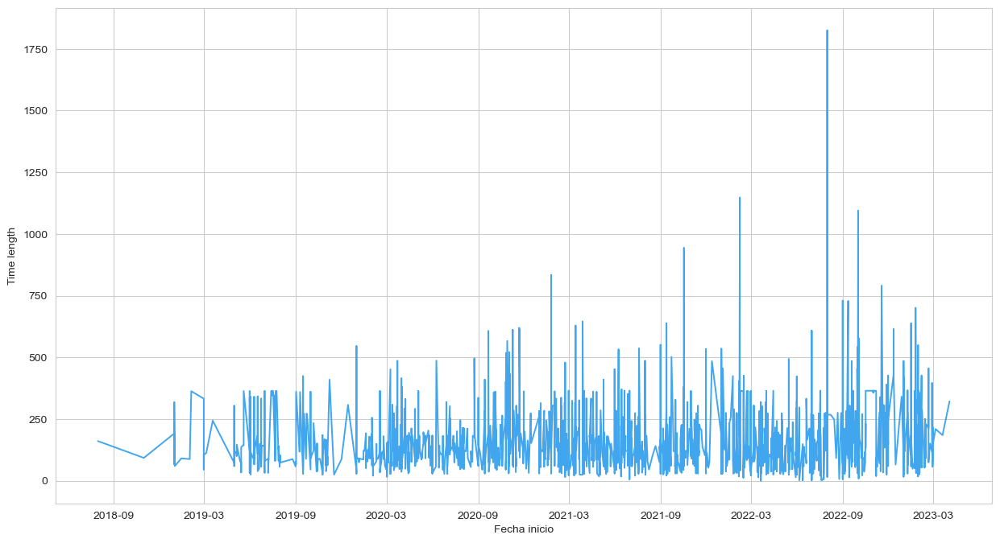

In [47]:
# Plot project length vs. date of start

fig, ax = plt.subplots(figsize=(15, 8))

half_year_locator = mdates.MonthLocator(interval=6)
year_month_formatter = mdates.DateFormatter("%Y-%m")

ax.xaxis.set_major_locator(half_year_locator)
ax.xaxis.set_major_formatter(year_month_formatter)

ax.plot(dates['Fecha inicio'].sort_values(), dates['Time length'], color='#42A6EF', linestyle='-' , linewidth=1.4)

plt.xlabel("Fecha inicio")
plt.ylabel("Time length")

### 4.2 Plazos

In [48]:
plazos = data[['Plazos']]
plazos['Plazos'].astype(str)
plazos

,Plazos
0,5 meses
3,3 meses
6,6 meses
9,4 meses
12,3 meses
15,10 meses
18,2 meses
21,2 meses
24,2 meses
27,10 meses


In [49]:
# Replace all troublesome strings

for idx, text in plazos['Plazos'].items():
    try:
        text = text.lower()
        plazos.loc[idx, 'Plazos'] = text.replace('(', '').replace(')', '').replace(',','.').replace("'",'.').replace("día","dia")
    except:
        pass

In [50]:
# Replacing all words-numbers as numbers 

def replace_numbers(text):
    # Define a dictionary with numbers written in words as keys and their numerical valuesas values
    numbers_dict = {"zero": 0, "uno": 1, "dos": 2, "tres": 3, "cuatro": 4, "cinco": 5, "seis": 6, "siete": 7, "ocho": 8, "nueve": 9, "diez": 10, "once": 11, "doce": 12, "trece": 13, "catorce": 14, "quince": 15, "dieciséis": 16, "diecisiete": 17, "dieciocho": 18, "diecinueve": 19, "veinte": 20, "trenta": 30, "cuarenta": 40, "cinquenta": 50, "sesenta": 60, "setenta": 70, "ochenta": 80, "noventa": 90}
    
    # Create a regular expression pattern to find numbers written in words
    pattern = re.compile(r'\b(' + '|'.join(numbers_dict.keys()) + r')\b')
    
    # Replace numbers written in words with their numerical values
    result = pattern.sub(lambda x: str(numbers_dict[x.group()]), text)
    
    return result

for idx, text in plazos['Plazos'].items():
    try:
        text = text.lower()
        plazos.loc[idx, 'Plazos'] = replace_numbers(text)
    except:
        pass
    
    

In [51]:
plazos

,Plazos
0,5 meses
3,3 meses
6,6 meses
9,4 meses
12,3 meses
15,10 meses
18,2 meses
21,2 meses
24,2 meses
27,10 meses


In [52]:
for idx, text in plazos['Plazos'].items():
    try:
        text = text.lower()
        if 'mes' in text:
            text = text.split('mes')[0].split(' ')[-2]
            
            # try/ecept to deal with decimasl
            try: 
                plazos.loc[idx, 'Plazos'] = float(text)*30 
            except:
                plazos.loc[idx, 'Plazos'] = int(text)*30 # transforming into days
            
        if 'seman' in text:
            text = text.split('seman')[0].split(' ')[-2]
            plazos.loc[idx, 'Plazos'] = int(text)*7 # transforming into days
            
        if 'año' in text:
            text = text.split('año')[0].split(' ')[-2]
            plazos.loc[idx, 'Plazos'] = int(text)*365 # transforming into days
        
        if 'dia' in text:
            text = text.split('dia')[0].split(' ')[-2]
            plazos.loc[idx, 'Plazos'] = int(text)
            
        if ' - ' in text:
            start_date, end_date = text.split(' - ')
            start = datetime.strptime(start_date, '%d/%m/%Y').date()
            end = datetime.strptime(end_date, '%d/%m/%Y').date()
            diff = (end-start).days
            plazos.loc[idx, 'Plazos'] = int(diff)
            
        if ' a ' in text:
            start_date, end_date = text.split(' a ')
            start_date = start_date.split(' ')[1]
            start = datetime.strptime(start_date, '%d/%m/%Y').date()
            end = datetime.strptime(end_date, '%d/%m/%Y').date()
            diff = (end-start).days
            plazos.loc[idx, 'Plazos'] = int(diff)
            
        if ' al ' in text:
            start_date, end_date = text.split(' al ')
            start_date = start_date.split(' ')[3]
            start = datetime.strptime(start_date, '%d/%m/%Y').date()
            end = datetime.strptime(end_date, '%d/%m/%Y').date()
            diff = (end-start).day
            plazos.loc[idx, 'Plazos'] = int(diff)
            
        if text == 'mejoras técnicas':
            plazos.loc[idx, 'Plazos'] = np.nan
        
    except:
        pass  

In [53]:
plazos
# plazos.to_excel('plazos.xlsx')

# Replace plazos in the original data set
# data['Plazos'] = plazos

,Plazos
0,150.0
3,90.0
6,180.0
9,120.0
12,90.0
15,300.0
18,60.0
21,60.0
24,60.0
27,300.0


## 5. Cost-related columns
### 5.1 Total solicitado

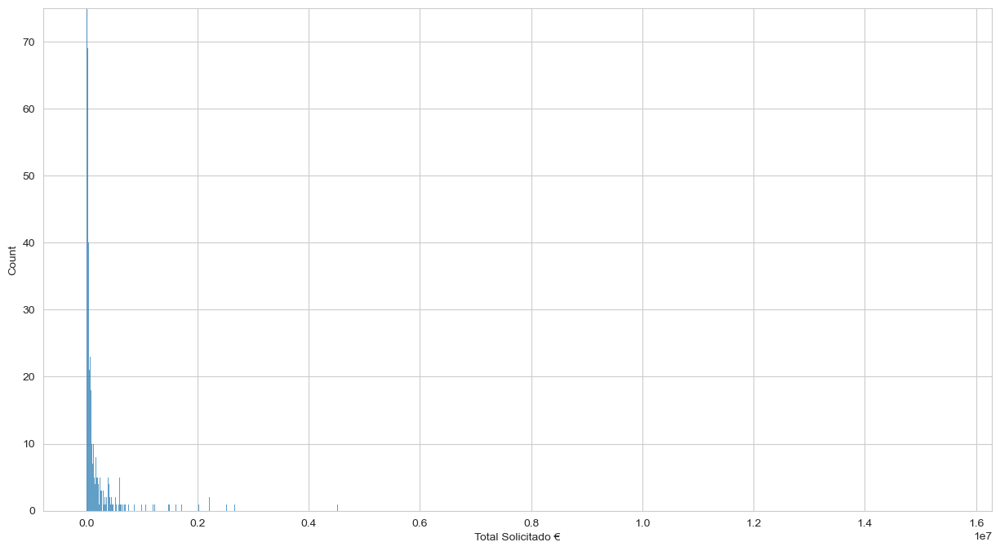

In [54]:
sns.histplot(data["Total Solicitado €"])
plt.ylim(0, 75)
# there are a lot of outliers
pd.set_option('float_format', '{:.2f}'.format)

In [55]:
data["Total Solicitado €"].describe()

count       3010.00
mean       75608.27
std       412814.79
min            0.35
25%           55.00
50%          300.00
75%        32469.25
max     15511260.00
Name: Total Solicitado €, dtype: float64

In [56]:
# We can see that there is an extreme outlier at 15M, but comparing with Capex / Opex, it looks like it makes sense and it 
# is not a typo or error of some kind.

### 5.2 Total Costes no IT Solicitado

In [57]:
costes = data[['Total COSTES no IT solicitado', 'Total Opex Solicitado','Total Capex Solicitado', 'Finanzas']]
costes

,Total COSTES no IT solicitado,Total Opex Solicitado,Total Capex Solicitado,Finanzas
0,0.00,0.00,45000.00,CAPEX: 45.0 K / OPEX: 0.0 K
3,0.00,0.00,11844.30,CAPEX: 11.84 K / OPEX: 0.0 K
6,0.00,151000.00,0.00,CAPEX: 0.0 K / OPEX: 151.0 K
9,17563.16,0.00,95664.43,CAPEX: 95.66 K / OPEX: 17.56 K
12,0.00,0.00,12854.58,CAPEX: 12.85 K / OPEX: 0.0 K
15,0.00,32000.00,520300.00,CAPEX: 520.3 K€ / OPEX: 32.0 K€
18,0.00,0.00,5363.60,CAPEX: 5.36 K / OPEX: 0.0 K
21,0.00,0.00,5880.00,CAPEX: 5.88 K / OPEX: 0.0 K
24,0.00,0.00,172332.00,CAPEX: 172.33 K / OPEX: 0.0 K
27,0.00,17132.67,0.00,CAPEX: 0.0 K / OPEX: 17.13 K


In [58]:
costes['Total COSTES no IT solicitado'].isna().sum()

1814

In [59]:
costes[(costes['Total COSTES no IT solicitado']> 1) & (costes['Total COSTES no IT solicitado'] < 1000)] 

,Total COSTES no IT solicitado,Total Opex Solicitado,Total Capex Solicitado,Finanzas
529,200.00,0.00,26081.34,CAPEX: 26.08 K€ / OPEX: 0.0 K€
1502,200.00,0.00,43673.36,CAPEX: 43.67 K / OPEX: 0.2 K
2076,522.00,0.00,11259.00,CAPEX: 11.26 K / OPEX: 0.52 K


In [60]:
costes[costes['Total COSTES no IT solicitado'] > 0] # majority is 0

# we see that in most cases when "Total Opex Solicitado" == 0, the OPEX in "Finanzas" is given by the 
# "Total COSTES no IT solicitado", and in some cases it is 0.
# What I would do here is impute values or create another column as "Total no IT/Opex cost", given by the sum of
# "Total COSTES no IT solicitado" and Total Opex Solicitado"
#

,Total COSTES no IT solicitado,Total Opex Solicitado,Total Capex Solicitado,Finanzas
9,17563.16,0.00,95664.43,CAPEX: 95.66 K / OPEX: 17.56 K
235,28651.00,36917.00,0.00,CAPEX: 0.0 K / OPEX: 65.57 K
529,200.00,0.00,26081.34,CAPEX: 26.08 K€ / OPEX: 0.0 K€
605,22800.00,0.00,10514.50,CAPEX: 10.51 K€ / OPEX: 0.0 K€
637,129200.00,0.00,542482.69,CAPEX: 542.48 K€ / OPEX: 0.0 K€
766,4148667.44,2903.25,33186.05,CAPEX: 33.19 K / OPEX: 4484.43 K
1061,28500.00,24089.00,0.00,CAPEX: 0.0 K / OPEX: 52.59 K
1077,90720.00,0.00,989851.50,CAPEX: 989.85 K€ / OPEX: 0.0 K€
1267,61300.00,23464.00,0.00,CAPEX: 0.0 K / OPEX: 84.76 K
1382,15300.00,0.00,21463.43,CAPEX: 21.46 K€ / OPEX: 0.0 K€


### 5.3 Total CAPEX
- Convert it to numeric (change thousands and decimal separators)
- NAs count (impute with median)
- Summary statistics (substitute outlier values with Q3)

In [61]:
# Not necessary bc it's already in numeric format
#costes["Total Capex Solicitado"] = costes["Total Capex Solicitado"].str.replace('.', '') #thousands sep eliminated 
#costes["Total Capex Solicitado"] = pd.to_numeric(costes["Total Capex Solicitado"].str.replace(',', '.')) #decimal sep from comma to period
costes.dtypes

Total COSTES no IT solicitado    float64
Total Opex Solicitado            float64
Total Capex Solicitado           float64
Finanzas                          object
dtype: object

In [62]:
costes['Total Capex Solicitado'].isna().sum() #399 NAs == > cannot impute 0 as some projects have totcapex = 0 (if it was 0 it would have been recorded)

399

In [63]:
costes['Total Capex Solicitado'].describe().apply(lambda x: format(x, 'f'))
# the max is very far off the 3rd quartile, normally I would say there are outliers but maybe here is normal?

count        2611.000000
mean        68198.166688
std        332735.344875
min             0.000000
25%            28.405000
50%           222.220000
75%         34158.465000
max      12203300.000000
Name: Total Capex Solicitado, dtype: object

In [64]:
fig = px.box(costes, y="Total Capex Solicitado")
fig.show()

In [65]:
# Impute NAs with median

#df_freq['TotalCapexSolicitado'] = df_freq['TotalCapexSolicitado'].fillna(df_freq['TotalCapexSolicitado'].median())

### 5.4 Total Opex

In [66]:
costes['Total Opex Solicitado'].isna().sum()

399

In [67]:
costes['Total Opex Solicitado'].describe().apply(lambda x: format(x, 'f'))
# the max is very far off the 3rd quartile, normally I would say there are outliers but maybe here is normal?

count      2611.000000
mean       4617.132497
std       29410.178279
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max      534946.000000
Name: Total Opex Solicitado, dtype: object

In [68]:
fig = px.box(costes, y="Total Opex Solicitado")
fig.show()

### 5.5 Finanzas

In [69]:
costes['Finanzas'].isna().sum() 

271

## 6. Coste Solicitado (HTML)

In [70]:
total_suppliers = []
for i in data["Coste Solicitado"]:
    try:
        total_suppliers.append(pd.read_html(str(i)))
    except:
        total_suppliers.append(pd.NA)

In [71]:
pd.read_html(str(i))

[                                           Entrega  \
 0  Implantación de nuevas versiones de criptograma   
 1  Implantación de nuevas versiones de criptograma   
 2  Implantación de nuevas versiones de criptograma   
 3  Implantación de nuevas versiones de criptograma   
 4  Implantación de nuevas versiones de criptograma   
 5  Implantación de nuevas versiones de criptograma   
 6                                              NaN   
 
                   Nombre Clarity                 Naturaleza  \
 0  Soporte seguridad tecnologica            Consultorias IT   
 1                 Soporte Redsys            Consultorias IT   
 2               Desarrollos Host       Desarrollo de App SW   
 3                   Criptografía  Proyectos Infraestructura   
 4        Actualización e-Mission  Proyectos Infraestructura   
 5               Gestión proyecto       Desarrollo de App SW   
 6                            NaN                        NaN   
 
                Subsistema Capex / Opex   Cl

In [72]:
# have a list of proveedor in each line
# extract a list of proveedores, count, and then see. 

In [73]:
suppliers = []
for i in range(0,len(total_suppliers)):
    try:
        suppliers.append(total_suppliers[i][0]["Proveedor"])
    except:
        pass

In [74]:
total_suppliers[0][0]

,Entrega,Descripción,Unidad,Grupo de Artículos,Subservicio,Proveedor,Año 1,Año 2,Año 3,Año 4,Año 5
0,Capital regulatorio Q1/Q2,Capital regulatorio Q1/Q2,7614 - Finanzas,Trab Recurso ext T&M,0302.001 SABIS SW Usage Fee,ACCENTURE S.L.,45000.00,0.00,0.00,0.00,0.00


In [75]:
suppliers

[0    ACCENTURE S.L.
 Name: Proveedor, dtype: object,
 0    SABADELL INFORMATION SYSTEMS SAU
 1                      ACCENTURE S.L.
 Name: Proveedor, dtype: object,
 0    EY TRANSFORMA SERVICIOS CONSULTORIA
 1       INDRA BUSINESS CONSULTING, S.L.U
 Name: Proveedor, dtype: object,
 0     INDRA SOLUCIONES TECNOLOGIA INFORM.
 1                          ACCENTURE S.L.
 2                          ACCENTURE S.L.
 3     INDRA SOLUCIONES TECNOLOGIA INFORM.
 4                       KYNDRYL ESPAÑA SA
 5        SABADELL INFORMATION SYSTEMS SAU
 6       SABADELL INNOVATION CELLS, S.L.U.
 7                   NIF GENERICO SIN IRPF
 8                   NIF GENERICO SIN IRPF
 9     DXC TECHNOLOGY SERVICIOS ESPAÑA SLU
 10    DXC TECHNOLOGY SERVICIOS ESPAÑA SLU
 11                         ACCENTURE S.L.
 Name: Proveedor, dtype: object,
 0                         ACCENTURE S.L.
 1                         ACCENTURE S.L.
 2                         ACCENTURE S.L.
 3    DXC TECHNOLOGY SERVICIOS ESPAÑA SLU
 

In [76]:
suppliers_list = [item for sublist in suppliers for item in sublist]

In [77]:
# Convert the list to a pandas Series
suppliers_series = pd.Series(suppliers_list)
# Get the value counts of the Series
suppliers_counts = suppliers_series.value_counts()
print(suppliers_counts)

SABADELL INFORMATION SYSTEMS SAU       1454
ACCENTURE S.L.                         1079
NTT DATA SPAIN SLU                      901
DXC TECHNOLOGY SERVICIOS ESPAÑA SLU     273
ACCENTURE,S.L.                          270
GFT IT CONSULTING, S.L.                 261
NIF GENERICO SIN IRPF                   171
DELOITTE ADVISORY SL                    152
SABADELL INNOVATION CELLS, S.L.U.       147
BETTER CONSULTANTS, S.L.                122
MINSAIT PAYMENTS SYSTEMS, S.L.          115
KYNDRYL ESPAÑA SA                       109
ATOS ORIGIN SAE                         109
BANCO DE SABADELL, S.A.                  84
OPTIMISSA SERVICIOS PROFESIONALES S      68
INDRA BUSINESS CONSULTING, S.L.U         43
INDRA SOLUCIONES TECNOLOGIA INFORM.      39
EY TRANSFORMA SERVICIOS CONSULTORIA      30
EVOLUTIO CLOUD ENABLER SAU               21
TELEFONICA DE ESPAÑA, S.A.               21
SOPRA GROUP INFORMATICA SA               21
CAPITAL BANKING SOLUTIONS SAS            20
ADVOOST, S.L                    

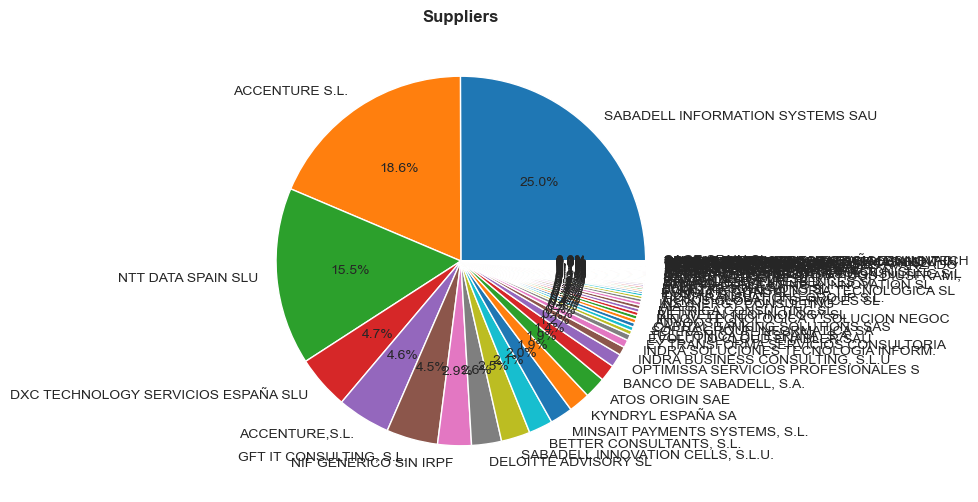

In [78]:
plt.figure(figsize=(8,6))
plt.pie(suppliers_counts.values, labels=suppliers_counts.index, autopct='%1.1f%%')
plt.title("Suppliers", fontweight='bold')
plt.show()

In [79]:
supplier_sabis = []
supplier_accenture = []
supplier_ntt = []
supplier_other = []

for i in range(len(df)):    
    try:
        temp_series = total_suppliers[i][0]["Proveedor"]
        has_a = 1 if temp_series.str.contains(r"accenture", case=False).any() else 0
        has_s = 1 if str(temp_series).lower().find("sabadell") != -1 else 0
        has_n = 1 if temp_series.str.contains(r"ntt", case=False).any() else 0
        has_o = 1 if ~temp_series.str.contains(r"accenture|sabadell|ntt", case=False).all() else 0 
            
        supplier_sabis.append(has_s)
        supplier_accenture.append(has_a)
        supplier_ntt.append(has_n)
        supplier_other.append(has_o)
    except:
        supplier_sabis.append(0)
        supplier_accenture.append(0)
        supplier_ntt.append(0)
        supplier_other.append(0)


In [80]:
# Append to original dataset:
#data['supplier_sabis'] = supplier_sabis
#data['supplier_accenture'] = supplier_accenture
#data['supplier_ntt'] = supplier_ntt
#data['supplier_other'] = supplier_other

In [81]:
data.head()

,Tipo de Entidad,Agrupación IT Demanda,Plan,Dominio,Programa,Clave,Resumen,Gestor Demanda,Unidad IT,Categoría,...,Costes recurrentes solicitado,Informacional,Área Peticionaria,Áreas involucradas,Agrupado PEP,Preselección para TCA,Otros costes,Mejoras Beneficios,Justificación Scoring y Unidades Colaboradoras,Unidades Colaboradoras
0,Business Case,SISTEMAS CORPORATIVOS,Financiera,Financial Reporting & Control,"PG-592, Capital Regulatorio y Control",PPR-41206,Capital Regulatorio Q1/Q2,JOSE ISAAC OSORIO TORRON,7614 - Finanzas,Mejoras aplicativas,...,NaN,No,7994 - Financiera y Finanzas Sostenibles,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,Scoring no realizado. No considero necesaria l...
3,Business Case,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-593, Venta de carteras",PPR-41175,Depuración BDD Venta Carteras,BERNAT PRADES ALGUERO,5881 - C&R y Gestión de Activos Irregulares,Mejoras aplicativas,...,NaN,Si,7932 - Riesgos,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,Scoring no realizado. No considero necesaria l...
6,Business Case,OPERACIONES Y TECNOLOGÍA EMPRESAS Y RED,Financiaciones,Producto,"PG-772, Financiaciones",PPR-40833,Factoring InBlock,SAMUEL JOSE GONZALEZ GARCIA,8411 - Gestión de Proyectos,Proyecto,...,NaN,No,8411 - Gestión de Proyectos,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,En esta primera fase se realizará solo el dise...,Scoring no realizado. No considero necesaria l...
9,Business Case,OPERACIONES Y TECNOLOGÍA PARTICULARES,"Prestamos, Tarjetas y Pagos",Préstamos,"PG-560, Financiación Préstamos",PPR-40784,Prést.Sabadell Digital- Alcance no MVP,MARIA DEL MAR LLORENS MIRO,7559 - Activo y Pasivo,Proyecto,...,NaN,No,4997 - Financiación y Medios de Pago,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,He cumplimentado scoring pero no he recibido v...
12,Business Case,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-594, Recuperaciones - Resolución findings O...",PPR-40748,F15 | Robustecimiento algoritmo Fase II,BERNAT PRADES ALGUERO,7997 - Data Solutions,Proyecto,...,NaN,Si,7932 - Riesgos,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,"No necesario, pequeño evolutivo sobre una apli...",Scoring no realizado. No considero necesaria l...


# PART 2: Exploring hours

## Before imputing NaN

In [8]:
# Checking null values before managing the column manually

hours = data[['Justificación y Cálculo de los Costes']]
hours['Justificación y Cálculo de los Costes'].astype(str)

hours['Justificación y Cálculo de los Costes'].isna().sum()

149

In [83]:
hours

,Justificación y Cálculo de los Costes
0,45000€ costes externos Accenture
3,+*Costes Internos*+ \n\nGestión SABIS 30h Tari...
6,*+Costes externos:+* \n\n*Asociación Española ...
9,Ver desglose en wiki \n
12,Costes unidades colaboradoras: \nTesting: 6027...
15,|Trabajos de analisis para buscar puntos de op...
18,"*Costes Externos - 140 horas - 5.363,60 €* \nP..."
21,COSTES EXTERNOS: \n* BETTER– Desarrollo proces...
24,Ver detalle en la wiki
27,+*Costes Sabis*+ \n\nSabis - 27 h (Tarifa Resp...


In [84]:
hours_words = ['horas','h', 'hora', 'hrs','hr']
for idx, text in hours['Justificación y Cálculo de los Costes'].items():
    try:
        text = text.lower()
        if any([word in text for word in hours_words]):
            hours.loc[idx, 'Justificación y Cálculo de los Costes'] = text
        else:
            hours.loc[idx, 'Justificación y Cálculo de los Costes'] = np.nan
    except:
        pass

In [85]:
no_hours_found = hours[hours['Justificación y Cálculo de los Costes'].isna()]

In [86]:
index_list = no_hours_found.index.tolist()

In [87]:
data['Justificación y Cálculo de los Costes'][index_list]

0                        45000€ costes externos Accenture
9                                 Ver desglose en wiki \n
24                                 Ver detalle en la wiki
62                             Ver detalles en WIki \n\n 
95      Costes: \n* ACCENTURE, S.L. Dossier Backoffice...
116     Compra licencias perpetuas: 89100€ \n\nMant. a...
122     Estimaciones y cálculos basados en los consumo...
125                      Se adjunta detalle en anexo wiki
128     Costes IT Totales proyecto: \n* ACCENTURE, S.L...
141                             Detalle de costes en Wiki
150     |Accenture - Valoración BCORP DCCA|7.137,00 €|...
156     Soporte BPs de Riesgos - Accenture : 48.960,00...
159                   Mejoras aplicativas primer semestre
184                               Ver desglose en la wiki
188                                  Ver detalles en Wiki
193                 Evolutivos 2023 - Ver detalle en wiki
196     Costes del proyecto: \n\nTIBCO  \n* Assessment...
214     |Coste

In [88]:
hours['Justificación y Cálculo de los Costes'].isna().sum()/len(hours)

0.32192691029900333

## After imputing NaN

In [39]:
# Exploring the column after managing rows manually

data_cleaned = pd.read_excel("data_no_empty_rows.xlsx")
data_cleaned

,Unnamed: 0,Tipo de Entidad,Agrupación IT Demanda,Plan,Dominio,Programa,Clave,Resumen,Gestor Demanda,Unidad IT,...,Áreas involucradas,Agrupado PEP,Preselección para TCA,Otros costes,Mejoras Beneficios,Justificación Scoring y Unidades Colaboradoras,Unidades Colaboradoras,Horas,Cost,Text
0,0,Business Case,SISTEMAS CORPORATIVOS,Financiera,Financial Reporting & Control,"PG-592, Capital Regulatorio y Control",PPR-41206,Capital Regulatorio Q1/Q2,JOSE ISAAC OSORIO TORRON,7614 - Finanzas,...,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,Scoring no realizado. No considero necesaria l...,NaN,45000,NaN
1,3,Business Case,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-593, Venta de carteras",PPR-41175,Depuración BDD Venta Carteras,BERNAT PRADES ALGUERO,5881 - C&R y Gestión de Activos Irregulares,...,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,Scoring no realizado. No considero necesaria l...,330.000000,NaN,NaN
2,6,Business Case,OPERACIONES Y TECNOLOGÍA EMPRESAS Y RED,Financiaciones,Producto,"PG-772, Financiaciones",PPR-40833,Factoring InBlock,SAMUEL JOSE GONZALEZ GARCIA,8411 - Gestión de Proyectos,...,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,En esta primera fase se realizará solo el dise...,Scoring no realizado. No considero necesaria l...,90.000000,NaN,NaN
3,9,Business Case,OPERACIONES Y TECNOLOGÍA PARTICULARES,"Prestamos, Tarjetas y Pagos",Préstamos,"PG-560, Financiación Préstamos",PPR-40784,Prést.Sabadell Digital- Alcance no MVP,MARIA DEL MAR LLORENS MIRO,7559 - Activo y Pasivo,...,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,He cumplimentado scoring pero no he recibido v...,NaN,NaN,wiki
4,12,Business Case,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-594, Recuperaciones - Resolución findings O...",PPR-40748,F15 | Robustecimiento algoritmo Fase II,BERNAT PRADES ALGUERO,7997 - Data Solutions,...,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,"No necesario, pequeño evolutivo sobre una apli...",Scoring no realizado. No considero necesaria l...,412.000000,NaN,NaN
5,15,Business Case,SABIS - SERVICIOS TECNOLÓGICOS,Servicios Tecnológicos,Production,"PG-390, Resiliencia",PPR-40601,Resiliencia middleware 2023,MARIA VEIGA CALVO,8959 - Plataforma de Banca Empresas y Particul...,...,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,La participación principal a nivel de certific...,He cumplimentado scoring y recogido la valorac...,NaN,552300,NaN
6,18,Business Case,OPERACIONES Y TECNOLOGÍA PARTICULARES,Hipotecas & Consumer Finance,Hipotecas,"PG-525, Proceso hipotecario",PPR-40536,Listado AA valor 2022 y contable 2023,MARIA LOPEZ BENVENUTY,7559 - Activo y Pasivo,...,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,NaN,Scoring no realizado. No considero necesaria l...,290.000000,NaN,NaN
7,21,Business Case,SISTEMAS CORPORATIVOS,Gestión de Riesgos,Gestión de Riesgos,"PG-306, Oficina de garantías",PPR-40380,EPA - Aprovisionamiento datos,BERNAT PRADES ALGUERO,5881 - C&R y Gestión de Activos Irregulares,...,NaN,\n{html}\n<table border='0' cellpadding='5' ce...,No,\n{html}\n<table border='0' cellpadding='5' ce...,\n{html}\n<table border='0' cellpadding='5' ce...,Proceso a medida de extracción de información ...,Scoring no realizado. No considero nece

In [47]:
# Getting final number of NaN
print(f"There are {data_cleaned['Horas'].isna().sum()} instances with missing Hours")
print(f"This equals to {data_cleaned['Horas'].isna().sum()/len(data_cleaned)*100}% instances with missing Hours")

There are 1298 instances with missing Hours
This equals to 43.12292358803987% instances with missing Hours


In [48]:
data_cleaned['Horas'].describe()

count      1712.000000
mean       2381.861153
std       20345.877623
min          10.000000
25%         303.750000
50%         760.250000
75%        1817.000000
max      792983.700000
Name: Horas, dtype: float64

<AxesSubplot:xlabel='Horas', ylabel='Count'>

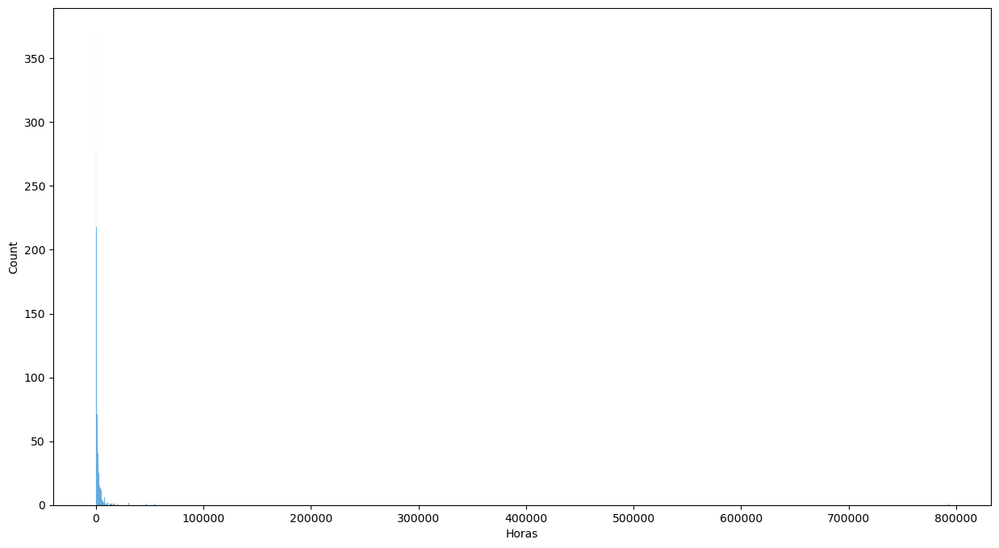

In [27]:
# Plotting project hours

plt.figure(figsize=(15,8))
sns.histplot(x="Horas", data=data_cleaned, color='#42A6EF')

In [64]:
data_cleaned = data_cleaned[data_cleaned['Horas'].notnull()]
#data_cleaned = data_cleaned.drop(columns=["Unnamed: 0"])
data_cleaned.to_csv("data_cleaned.csv")